In [1]:
import torch, torchvision
from PIL import Image
from transfer import StyleTransfer, StyleTransferLoss
import os
import matplotlib.pyplot as plt
from glob import glob

### This notebook is intended for exploring the different layers of the vgg network and what information they hold.

In [2]:
content = Image.open("content-style_image/venice.jpg")
style = Image.open('./content-style_image/good.jpg')
style = style.resize(content.size)

# Making image transformers
new_size = 600
trans = torchvision.transforms.Compose([
    torchvision.transforms.Resize(new_size),
    torchvision.transforms.ToTensor()
])

# Making content and style images acceptable for the network.
c = trans(content).unsqueeze(0)
s = trans(style).unsqueeze(0)

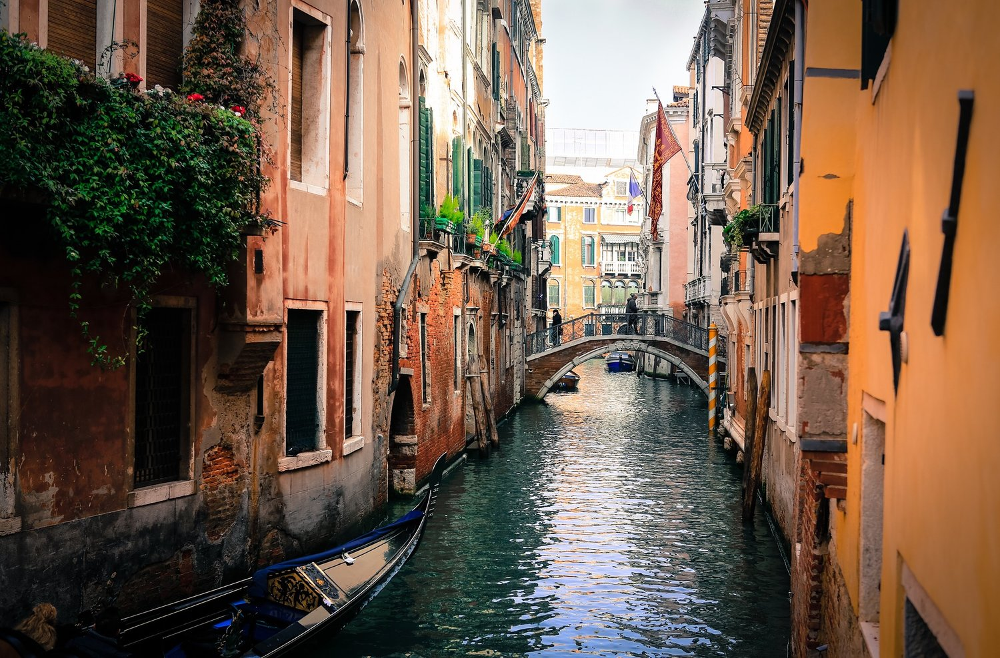

In [3]:
content

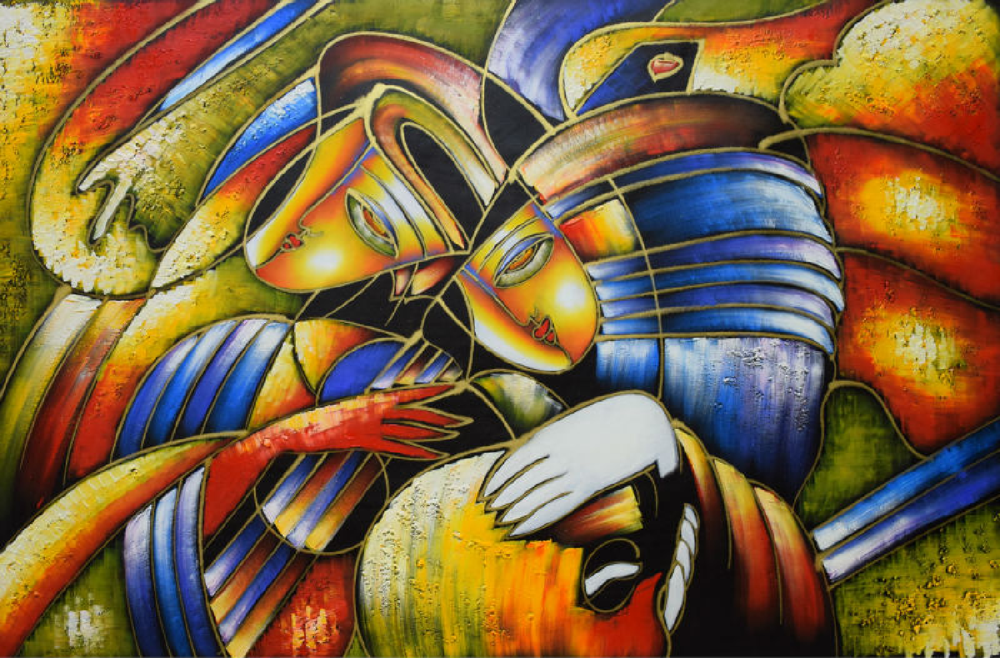

In [4]:
style

# Generating Style Transfer Model

In [8]:
vgg19 = torchvision.models.vgg19(pretrained=True).features.eval()
lr = 1
n_epochs = 101
# transferer = StyleTransfer(vgg11.cuda(), c.cuda(), s.cuda(), [4], [-1], alpha=1000000, beta=1).cuda()
# total_loss = StyleTransferLoss(transferer.style_losses, transferer.alpha, transferer.content_losses, transferer.beta)

# var_img = torch.randn(c.shape).cuda().requires_grad_()

# optimizer = torch.optim.LBFGS([var_img], lr=lr)
# n_epochs = 20

In [9]:
for beta in [10000]:
    convs = []
    style_weights = []
    for conv_ix in range(5, 6):
        print('conv_ix', conv_ix, " , Beta:", beta)
        print("Model with {} conv ixs.".format(conv_ix))
        transferer = StyleTransfer(vgg19.cuda(), c.cuda(), s.cuda(), content_ixs=[-1], style_ixs=[conv_ix], style_weights=[1], alpha=1, beta=beta).cuda()
        total_loss = StyleTransferLoss(style_losses=transferer.style_losses, beta=transferer.beta,
                                   content_losses=transferer.content_losses, alpha=transferer.alpha)

        var_img = torch.randn(c.shape).cuda().requires_grad_()
        optimizer = torch.optim.LBFGS([var_img], lr=lr)

        save_dir = './exp8_style_vis/style_b{}/style_0-{}/'.format(beta, conv_ix)
        os.makedirs(save_dir)

        for epoch in range(n_epochs):
            def closure():        
                optimizer.zero_grad()

                 # Run current image through the model.
                transferer(var_img)

                loss = total_loss()

                loss.backward()
                return loss

            optimizer.step(closure)

            # Every 20 iters save a pic.
            if epoch%10 == 0:
                print("Epoch: {}, Style Loss: {:6f}, Con Loss: {:6f}".format(epoch, 
                                                                             transferer.beta*total_loss.style_component, 
                                                                             transferer.alpha*total_loss.content_component))
                cpu_img = var_img.cpu()[0, :, :, :]
                cpu_img = torch.clamp(cpu_img, 0, 1)
                cpu_img = torchvision.transforms.ToPILImage()(cpu_img)
                cpu_img.save(save_dir + 'ep_{}_loss{:4f}.png'.format(epoch, transferer.beta*total_loss.style_component+transferer.alpha*total_loss.content_component))

conv_ix 5  , Beta: 10000
Model with 5 conv ixs.
Found style!  5  weight: 1
Epoch: 0, Style Loss: 43876.023438, Con Loss: 0.000000
Epoch: 10, Style Loss: 326.467041, Con Loss: 0.000000
Epoch: 20, Style Loss: 69.314667, Con Loss: 0.000000
Epoch: 30, Style Loss: 26.456963, Con Loss: 0.000000
Epoch: 40, Style Loss: 13.209651, Con Loss: 0.000000
Epoch: 50, Style Loss: 7.695305, Con Loss: 0.000000
Epoch: 60, Style Loss: 4.923986, Con Loss: 0.000000
Epoch: 70, Style Loss: 3.389327, Con Loss: 0.000000
Epoch: 80, Style Loss: 2.461039, Con Loss: 0.000000
Epoch: 90, Style Loss: 1.868525, Con Loss: 0.000000
Epoch: 100, Style Loss: 1.452503, Con Loss: 0.000000


['./exp8_style_vis/style_b10000/style_0-0\\ep_100_loss0.000000.png']
['./exp8_style_vis/style_b10000/style_0-1\\ep_100_loss0.000004.png']
['./exp8_style_vis/style_b10000/style_0-2\\ep_100_loss0.000012.png']
['./exp8_style_vis/style_b10000/style_0-3\\ep_100_loss0.002064.png']
['./exp8_style_vis/style_b10000/style_0-4\\ep_100_loss0.017617.png']
['./exp8_style_vis/style_b10000/style_0-5\\ep_100_loss1.452503.png']


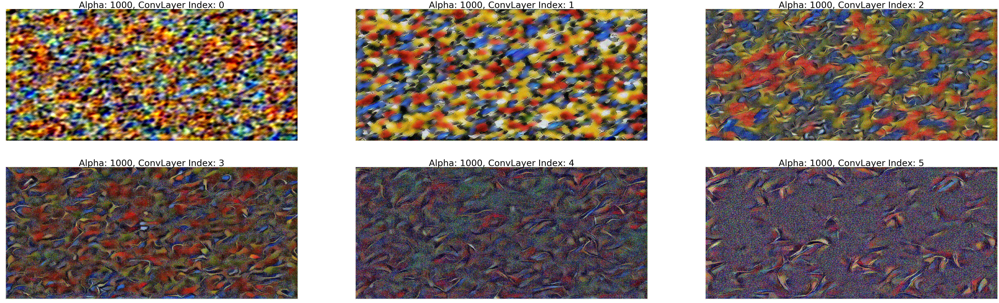

In [13]:
fig, axs = plt.subplots(2,3, figsize=(100,30))
for c_ix, ax in enumerate(axs.flatten()):
    files = glob('./exp8_style_vis/style_b10000/style_0-{}/ep_100*'.format(c_ix))
    print(files)
    ax.axis("off")
    ax.set_title('Alpha: {}, ConvLayer Index: {}'.format(1000, c_ix), fontsize=50)
    ax.imshow(plt.imread(files[-1]), aspect='auto')
    
fig.add_subplot(111, frameon=False)
plt.xticks([])
plt.yticks([])    
plt.savefig('./report_images/style_reconstruction.png')